In [2]:
import requests
import json
import pandas as pd
import seaborn as sb
import numpy as np
import matplotlib.pyplot as plt
import datetime as dt

In [3]:
BALSHT = requests.get('https://www.alphavantage.co/query?function=BALANCE_SHEET&symbol=AAPL&apikey=BNM3OK9KHBBVD3YZ') #api request for balance sheet for AAPL
INCSTAT = requests.get('https://www.alphavantage.co/query?function=INCOME_STATEMENT&symbol=AAPL&apikey=BNM3OK9KHBBVD3YZ') #api request for income statement for AAPL
TSERIES = requests.get('https://www.alphavantage.co/query?function=TIME_SERIES_DAILY_ADJUSTED&symbol=aapl&outputsize=full&apikey=GZZHIBO1SGTLPGB1')

bsolddf = pd.read_excel("AAPL BAL SHEET.xls")

isolddf = pd.read_excel("AAPL INCOME SHEET.xls")

interest = pd.read_csv('FEDFUNDS.csv',index_col=0)

In [4]:
bsdata = BALSHT.text
bsparsed = json.loads(bsdata)
bsquartdata = bsparsed['quarterlyReports']
bsquartdf = pd.DataFrame.from_dict(bsquartdata)

isdata = INCSTAT.text
isparsed = json.loads(isdata)
isquartdata = isparsed['quarterlyReports']
isquartdf = pd.DataFrame.from_dict(isquartdata)

data = TSERIES.text
parsed = json.loads(data)
tsdata = parsed['Time Series (Daily)']
tsda = pd.DataFrame.from_dict(tsdata, orient='index')
tsda_new=tsda.loc[:'2009-01-02',]

In [5]:
#price variable
price=tsda_new.drop(['1. open','2. high','3. low','4. close','6. volume','7. dividend amount','8. split coefficient'],1)
price.rename(columns={"5. adjusted close":"price"},inplace=True)
price.price = pd.to_numeric(price.price)
price.index = pd.to_datetime(price.index)
price.index=price.index.map(dt.datetime.toordinal)

In [6]:
#extracting dividends from tsda_new
dividend=tsda_new.drop(['1. open','2. high','3. low','5. adjusted close','6. volume','8. split coefficient'],1)
dividend.rename(columns={"4. close":"price","7. dividend amount":"adjusted_dividend"},inplace=True)
#cleaning of dividend data
dividend.adjusted_dividend = pd.to_numeric(dividend.adjusted_dividend)
dividend.price = pd.to_numeric(dividend.price)
dividend.index = pd.to_datetime(dividend.index)
dividend.index=dividend.index.map(dt.datetime.toordinal)
#remove zeroes
indexNames = dividend[ dividend['adjusted_dividend'] == 0 ].index
dividend.drop(indexNames , inplace=True)
#account for stock split
dividend_before_2020=dividend.loc['2020-08-07':,]
dividend_before_2020=(dividend_before_2020)/4
dividend_before_2014=dividend_before_2020.loc['2014-05-08':,]
dividend_before_2014=dividend_before_2014/7
dividend.update(dividend_before_2020)
dividend.update(dividend_before_2014)
dividend['dividend_yield'] = dividend['adjusted_dividend']/dividend['price']*100
dividend = dividend.drop(['price'],1)

In [7]:
interest.index = pd.to_datetime(interest.index)
interest.index = interest.index.map(dt.datetime.toordinal)
interest = interest.drop(interest.columns[1:], axis=1)

In [8]:
#adding variables to the dataframe
price.insert(1, "fed_interest",np.nan)
price.insert(2, "dividend_yield",np.nan)
price.update(interest)
price.update(dividend)

#Adding data points for quarterly dividend yield
div=0
date=4417
i=price.shape[0]-1
for date in price.index:
    if pd.isnull(price.iloc[i,2]):
        price.iloc[i,2]=div
        i-=1
    else:
        div=price.iloc[i,2]
        i-=1

price.index.names = ['Date']

In [9]:
lnprice = tsda_new.drop(['1. open','2. high','3. low','4. close','6. volume', '7. dividend amount', '8. split coefficient'],1)
lnprice.rename(columns={"5. adjusted close":"price"},inplace=True)

lnprice.price = pd.to_numeric(lnprice.price)
lnprice.index = pd.to_datetime(lnprice.index)
lnprice.index=lnprice.index.map(dt.datetime.toordinal)
lnprice['lnprice'] = np.log(lnprice['price'])
lnprice = lnprice.drop('price', axis = 1)

lnprice.index.name = 'Date'

In [10]:
merged = price.copy(deep=True)
merged.insert(3, "lnprice",np.nan)
merged.update(lnprice)

In [11]:
assets_liab_new = bsquartdf[['fiscalDateEnding', 'totalAssets', 'totalLiabilities']]
assets_liab_new['fiscalDateEnding'] = pd.to_datetime(assets_liab_new['fiscalDateEnding'])
assets_liab_new[['totalAssets', 'totalLiabilities']] = assets_liab_new[['totalAssets', 'totalLiabilities']].apply(pd.to_numeric)
assets_liab_old = bsolddf[['Period End Date', 'TOTAL ASSETS', 'TOTAL LIABILITIES']]
new_cols = {x: y for x, y in zip(assets_liab_old.columns, assets_liab_new.columns)}
assets_liab1 = assets_liab_new.append(assets_liab_old.rename(columns=new_cols))
assets_liab = assets_liab1.set_index('fiscalDateEnding')

assets_liab.loc['2019-06-30	', 'totalLiabilities'] = 225783000000
assets_liab.loc['2019-03-31', 'totalLiabilities'] = 236138000000
assets_liab.loc['2018-12-31', 'totalLiabilities'] = 255827000000
assets_liab.loc['2018-09-30', 'totalLiabilities'] = 258578000000

<ipython-input-11-f16ba6565ca0>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  assets_liab_new['fiscalDateEnding'] = pd.to_datetime(assets_liab_new['fiscalDateEnding'])
C:\Users\jovin\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [12]:
profits_new = isquartdf[['fiscalDateEnding', 'grossProfit']]
profits_new['fiscalDateEnding'] = pd.to_datetime(profits_new['fiscalDateEnding'])
profits_new['grossProfit'] = pd.to_numeric(profits_new['grossProfit'])
profits_old = isolddf[['Period End Date', 'Gross Profit']]
new_cols = {x: y for x, y in zip(profits_old.columns, profits_new.columns)}
profits1 = profits_new.append(profits_old.rename(columns=new_cols))
profits = profits1.set_index('fiscalDateEnding')

<ipython-input-12-c978ad88f7f9>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  profits_new['fiscalDateEnding'] = pd.to_datetime(profits_new['fiscalDateEnding'])
<ipython-input-12-c978ad88f7f9>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  profits_new['grossProfit'] = pd.to_numeric(profits_new['grossProfit'])


In [13]:
assets_liab_ordinal = assets_liab.copy(deep=True)
assets_liab_ordinal.index = assets_liab_ordinal.index.map(dt.datetime.toordinal)
profits_ordinal = profits.copy(deep=True)
profits_ordinal.index = profits_ordinal.index.map(dt.datetime.toordinal)

db_clean = pd.DataFrame({'Date': tsda_new.index, 'totalAssets': np.nan, 'totalLiabilities': np.nan, 'grossProfit': np.nan})
db_clean['Date'] = pd.to_datetime(db_clean['Date'])
db_clean = db_clean.set_index('Date')
db_clean.index = db_clean.index.map(dt.datetime.toordinal)

In [14]:
i = 0
date = assets_liab_ordinal.index[i]

for d in db_clean.index:
    if d >= date:
        db_clean.loc[d, 'totalAssets'] = assets_liab_ordinal.iloc[i, 0]
        db_clean.loc[d, 'totalLiabilities'] = assets_liab_ordinal.iloc[i, 1]
        db_clean.loc[d, 'grossProfit'] = profits_ordinal.iloc[i, 0]
    else:
        i = i+1
        date = assets_liab_ordinal.index[i]
        db_clean.loc[d, 'totalAssets'] = assets_liab_ordinal.iloc[i, 0]
        db_clean.loc[d, 'totalLiabilities'] = assets_liab_ordinal.iloc[i, 1]
        db_clean.loc[d, 'grossProfit'] = profits_ordinal.iloc[i, 0]

In [15]:
merged.insert(4, "totalAssets",np.nan)
merged.insert(5, "totalLiabilities",np.nan)
merged.insert(6, "grossProfit",np.nan)

In [16]:
merged.update(db_clean)
merged['Date'] = merged.index
merged['ass-liab'] = merged['totalAssets'] - merged['totalLiabilities']

In [18]:
merged

,price,fed_interest,dividend_yield,lnprice,totalAssets,totalLiabilities,grossProfit,Date,ass-liab
Date,,,,,,,,,
737888,130.360000,0.07,0.149898,4.870300,3.540540e+11,2.878300e+11,4.432800e+10,737888,6.622400e+10
737887,127.900000,0.07,0.149898,4.851249,3.540540e+11,2.878300e+11,4.432800e+10,737887,6.622400e+10
737886,126.210000,0.07,0.149898,4.837947,3.540540e+11,2.878300e+11,4.432800e+10,737886,6.622400e+10
737885,125.900000,0.07,0.149898,4.835488,3.540540e+11,2.878300e+11,4.432800e+10,737885,6.622400e+10
737881,123.000000,0.07,0.149898,4.812184,3.540540e+11,2.878300e+11,4.432800e+10,737881,6.622400e+10
...,...,...,...,...,...,...,...,...,...
733415,2.851361,0.15,0.000000,1.047796,4.278700e+10,1.987800e+10,4.507000e+09,733415,2.290900e+10
733414,2.799378,0.15,0.000000,1.029397,4.278700e+10,1.987800e+10,4.507000e+09,733414,2.290900e+10
733413,2.861204,0.15,0.000000,1.051242,4.278700e+10,1.987800e+10,4.507000e+09,733413,2.290900e+10


In [20]:
merged.corr()

,price,fed_interest,dividend_yield,lnprice,totalAssets,totalLiabilities,grossProfit,Date,ass-liab
price,1.000000,0.281697,0.087665,0.877951,0.666927,0.794397,0.691128,0.839514,0.071288
fed_interest,0.281697,1.000000,0.203923,0.456499,0.608163,0.642173,0.382018,0.574682,0.274456
dividend_yield,0.087665,0.203923,1.000000,0.396549,0.618600,0.425001,0.416207,0.465774,0.860402
lnprice,0.877951,0.456499,0.396549,1.000000,0.893891,0.913721,0.822817,0.965465,0.480217
totalAssets,0.666927,0.608163,0.618600,0.893891,1.000000,0.959533,0.823453,0.949017,0.696803
totalLiabilities,0.794397,0.642173,0.425001,0.913721,0.959533,1.000000,0.801588,0.976803,0.466627
grossProfit,0.691128,0.382018,0.416207,0.822817,0.823453,0.801588,1.000000,0.812641,0.544602
Date,0.839514,0.574682,0.465774,0.965465,0.949017,0.976803,0.812641,1.000000,0.492684
ass-liab,0.071288,0.274456,0.860402,0.480217,0.696803,0.466627,0.544602,0.492684,1.000000


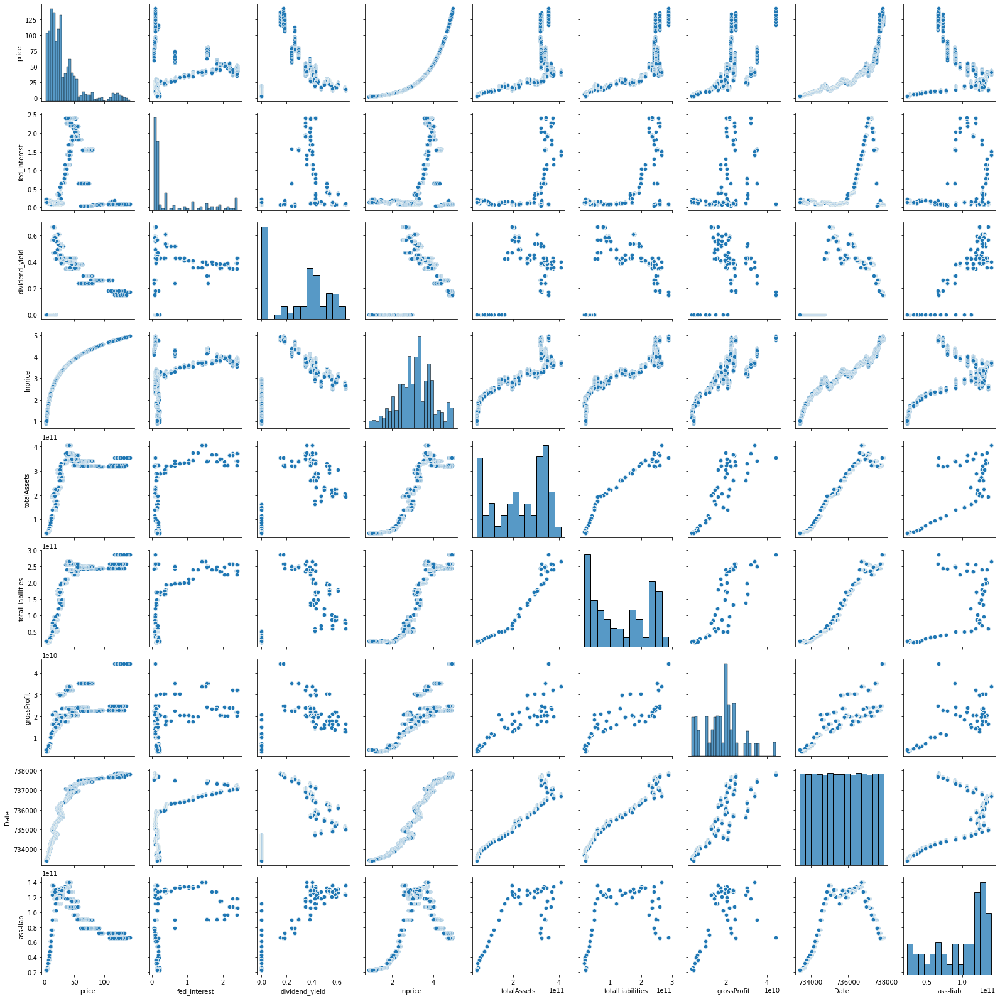

In [17]:
sb.pairplot(merged)